In [2]:
pip install librosa

  Using cached librosa-0.10.2.post1-py3-none-any.whl.metadata (8.6 kB)
  Using cached audioread-3.0.1-py3-none-any.whl.metadata (8.4 kB)
Using cached librosa-0.10.2.post1-py3-none-any.whl (260 kB)
Using cached audioread-3.0.1-py3-none-any.whl (23 kB)
   ---------------------------------------- 0.0/2.8 MB ? eta -:--:--
   ---------------------------------------- 0.0/2.8 MB ? eta -:--:--
   --- ------------------------------------ 0.3/2.8 MB ? eta -:--:--
   ------- -------------------------------- 0.5/2.8 MB 882.6 kB/s eta 0:00:03
   ------- -------------------------------- 0.5/2.8 MB 882.6 kB/s eta 0:00:03
   ----------- ---------------------------- 0.8/2.8 MB 819.2 kB/s eta 0:00:03
   ----------- ---------------------------- 0.8/2.8 MB 819.2 kB/s eta 0:00:03
   ------------------ --------------------- 1.3/2.8 MB 919.8 kB/s eta 0:00:02
   ---------------------- ----------------- 1.6/2.8 MB 976.0 kB/s eta 0:00:02
   ----------------------------- ---------- 2.1/2.8 MB 1.2 MB/s eta 0:00:0

In [1]:
import librosa
import librosa.display
import scipy as sp
import IPython.display as ipd
import matplotlib.pyplot as plt
import numpy as np

In [5]:
audio_path = "C:\\Users\\IIT\\Downloads\\Raaz Aankhein Teri - Raaz Reboot 320 Kbps.mp3"
ipd.Audio(audio_path)

In [6]:
audio_path = "C:\\Users\\IIT\\Downloads\\Aadat Kalyug 320 Kbps.mp3"
ipd.Audio(audio_path)

In [2]:
audio_path_1 = "D:\\Underwater_Data\\Inc_2000_Exc_4000\\test\\tanker\\2.wav"
#ipd.Audio(audio_path_1)

In [4]:
signal, sr = librosa.load(audio_path_1)

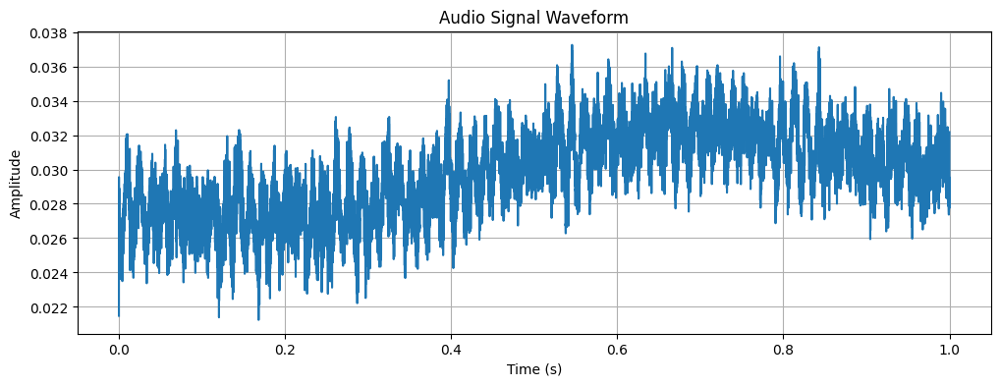

In [5]:
time = np.linspace(0, len(signal) / sr, num=len(signal))

# Plot the waveform
plt.figure(figsize=(12, 4))
plt.plot(time, signal)
plt.title("Audio Signal Waveform")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.grid(True)
plt.show()

In [4]:
pip install -i https://test.pypi.org/simple/ nnAudio2

Looking in indexes: https://test.pypi.org/simple/
Note: you may need to restart the kernel to use updated packages.


In [2]:
import torch
import librosa
from nnAudio2 import Spectrogram
import matplotlib.pyplot as plt
import torch
import os
import time

**1. MEL Spectrogram feature extraction**

In [ ]:
audio_1,_ = librosa.load(audio_path_1,sr=1.46*22050)

In [13]:
features=librosa.feature.melspectrogram(y=audio_1, sr=1.46*22050,n_fft=1024, hop_length=256, window='hann', center=True, pad_mode='constant', power=2.0, n_mels=95,fmin=0,fmax=None)
log_mel_spectrogram = librosa.power_to_db(features)

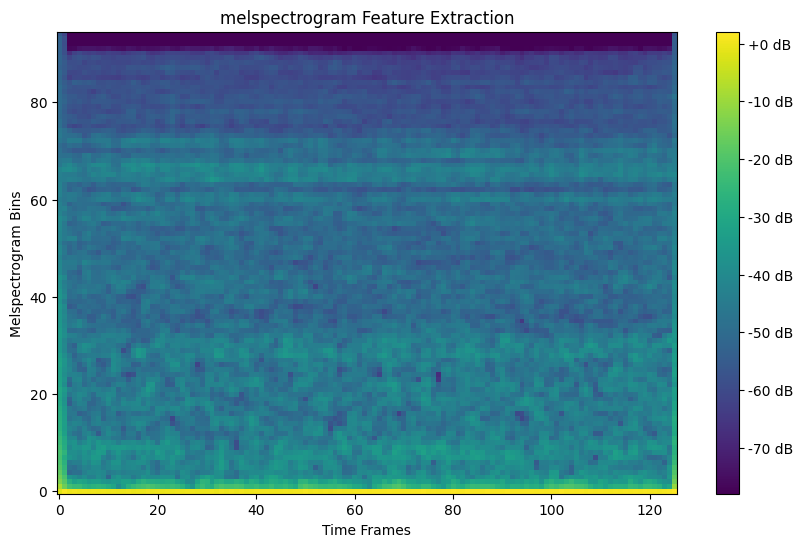

Melspectrogram Features Shape: (95, 126)


In [14]:
plt.figure(figsize=(10, 6))
plt.imshow(log_mel_spectrogram, aspect='auto', origin='lower', cmap='viridis')
plt.colorbar(format="%+2.0f dB")
plt.title("melspectrogram Feature Extraction")
plt.xlabel("Time Frames")
plt.ylabel("Melspectrogram Bins")
plt.show()
# Optionally, you can convert it to a NumPy array if needed
melspectrogram_features_numpy =log_mel_spectrogram
print(f"Melspectrogram Features Shape: {melspectrogram_features_numpy.shape}")

In [ ]:
def melspectrogram(file_path):
    audio,_ = librosa.load(file_path,sr=1.46*22050)
    features=librosa.feature.melspectrogram(
        y=audio,
        sr=1.46*22050,
        n_fft=1024,
        hop_length=256,
        window='hann',
        center=True,
        pad_mode='constant',
        power=2.0,
        n_mels=95,
        fmin=18,
        fmax=4186)
    mel_spec_db = librosa.power_to_db(features, ref=np.max)
    return mel_spec_db

In [ ]:
INPUT_FOLDER = "D:\\Underwater_Data\\Inc_4000_Exc_6000"  # Replace with your folder path
OUTPUT_FOLDER = "D:\\Underwater_Data\\MELSPECTROGRAM_46"  # Where features will be saved

# Create output directory if it doesn't exist
os.makedirs(OUTPUT_FOLDER, exist_ok=True)
def process_dataset_mel(input_folder, output_folder):
    for split in ['test', 'train','validation']:  # Process each split
        split_path = os.path.join(input_folder, split)
        output_split_folder = os.path.join(output_folder, split)
        os.makedirs(output_split_folder, exist_ok=True)

        for class_name in os.listdir(split_path):  # Iterate over class folders
            class_path = os.path.join(split_path, class_name)

            if os.path.isdir(class_path):  # Ensure it's a directory
                print(f"Processing {split}/{class_name}")
                output_class_folder = os.path.join(output_split_folder, class_name)
                os.makedirs(output_class_folder, exist_ok=True)

                for file_name in os.listdir(class_path):
                    if file_name.endswith('.wav'):
                        file_path = os.path.join(class_path, file_name)
                        mel_spec =melspectrogram(file_path)

                        if mel_spec is not None:
                            # Save the Mel spectrogram as a .npy file
                            output_file_path = os.path.join(output_class_folder, file_name.replace('.wav', '.npy'))
                            np.save(output_file_path, mel_spec)
                            print(f"Saved Mel spectrogram: {output_file_path}")


In [ ]:
# Process the dataset
process_dataset_mel(INPUT_FOLDER, OUTPUT_FOLDER)

Processing test/background
Saved Mel spectrogram: D:\Underwater_Data\MELSPECTROGRAM_46\test\background\100.npy
Saved Mel spectrogram: D:\Underwater_Data\MELSPECTROGRAM_46\test\background\1004.npy
Saved Mel spectrogram: D:\Underwater_Data\MELSPECTROGRAM_46\test\background\1005.npy
Saved Mel spectrogram: D:\Underwater_Data\MELSPECTROGRAM_46\test\background\1007.npy
Saved Mel spectrogram: D:\Underwater_Data\MELSPECTROGRAM_46\test\background\101.npy
Saved Mel spectrogram: D:\Underwater_Data\MELSPECTROGRAM_46\test\background\1011.npy
Saved Mel spectrogram: D:\Underwater_Data\MELSPECTROGRAM_46\test\background\1012.npy
Saved Mel spectrogram: D:\Underwater_Data\MELSPECTROGRAM_46\test\background\1013.npy
Saved Mel spectrogram: D:\Underwater_Data\MELSPECTROGRAM_46\test\background\1016.npy
Saved Mel spectrogram: D:\Underwater_Data\MELSPECTROGRAM_46\test\background\1018.npy
Saved Mel spectrogram: D:\Underwater_Data\MELSPECTROGRAM_46\test\background\1020.npy
Saved Mel spectrogram: D:\Underwater_Dat

(95, 126)


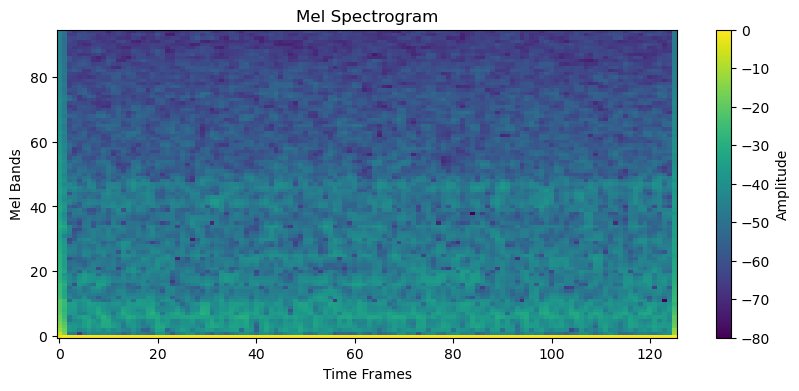

In [314]:
file_path = 'Inc_2000_Exc_4000_Melspectrogram_Ver_2\\train\\tug\\31583.npy'

# Load the Mel spectrogram features
mel_features = np.load(file_path)
print(mel_features.shape)
# Example visualization (optional)
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 4))
plt.imshow(mel_features, aspect='auto', origin='lower', cmap='viridis')
plt.colorbar(label='Amplitude')
plt.title('Mel Spectrogram')
plt.xlabel('Time Frames')
plt.ylabel('Mel Bands')
plt.show()

In [16]:
file_path="D:\\Underwater_Data\\Combined_three_features_Ver2\\test\\background\\0.npy"
mel_features = np.load(file_path)
print(mel_features.shape)

(3, 95, 126)


**2. Gammatonegram feature extraction**

In [5]:
import numpy as np

In [ ]:
gammatonegram = Spectrogram.Gammatonegram(
    sr=1.46*22050,
    n_fft=1024,         # FFT size
    n_bins=95,          # Number of Gammatone filters (bins)
    hop_length=256,     # Hop length
    window='hann',      # Window type
    center=True,        # Center frames
    pad_mode='reflect', # Padding mode
    htk=False,          # Use HTK normalization (set to False here)
    fmin=18,          # Minimum frequency for Gammatone filter
    fmax=4186,          # Maximum frequency (None means Nyquist)
    norm=1,             # Normalization
    trainable_bins=False, # Non-trainable filter bins
    trainable_STFT=False, # Non-trainable STFT
    device='cpu'        # Force CPU usage instead of CUDA
)

STFT filter created, time used = 0.0030 seconds
Gammatone filter created, time used = 0.0030 seconds


In [8]:
def gammatogram_f(file_path):
    audio,_ = librosa.load(file_path,sr=1.46*22050)
    audio_tensor = torch.tensor(audio).float()
    gammatone_features = gammatonegram(audio_tensor)
    mel_spec_db = librosa.power_to_db(gammatone_features, ref=np.max)
    return np.squeeze(mel_spec_db)

In [394]:
gammatogan_feature=gammatogram_f('D:\\Underwater_Data\\Inc_2000_Exc_4000\\test\\tanker\\2.wav')

(95, 126)


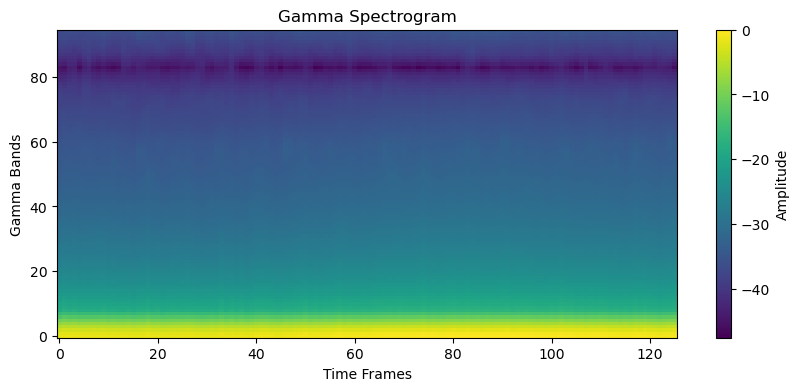

In [396]:
print(gammatogan_feature.shape)
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 4))
plt.imshow(gammatogan_feature, aspect='auto', origin='lower', cmap='viridis')
plt.colorbar(label='Amplitude')
plt.title('Gamma Spectrogram')
plt.xlabel('Time Frames')
plt.ylabel('Gamma Bands')
plt.show()

In [ ]:
INPUT_FOLDER = "D:\\Underwater_Data\\Inc_4000_Exc_6000"  # Replace with your folder path
OUTPUT_FOLDER = "D:\\Underwater_Data\\GAMM_46"  # Where features will be saved
os.makedirs(OUTPUT_FOLDER, exist_ok=True)
def process_dataset_gamma(input_folder, output_folder):
    for split in ['test', 'train','validation']:
        split_path = os.path.join(input_folder, split)
        output_split_folder = os.path.join(output_folder, split)
        os.makedirs(output_split_folder, exist_ok=True)

        for class_name in os.listdir(split_path):  # Iterate over class folders
            class_path = os.path.join(split_path, class_name)

            if os.path.isdir(class_path):  # Ensure it's a directory
                print(f"Processing {split}/{class_name}")
                output_class_folder = os.path.join(output_split_folder, class_name)
                os.makedirs(output_class_folder, exist_ok=True)

                for file_name in os.listdir(class_path):
                    if file_name.endswith('.wav'):
                        file_path = os.path.join(class_path, file_name)
                        gamma_spec =gammatogram_f(file_path)

                        if gamma_spec is not None:
                            # Save the Mel spectrogram as a .npy file
                            output_file_path = os.path.join(output_class_folder, file_name.replace('.wav', '.npy'))
                            np.save(output_file_path, gamma_spec)
                            print(f"Saved Mel spectrogram: {output_file_path}")


In [ ]:
process_dataset_gamma(INPUT_FOLDER, OUTPUT_FOLDER)

Processing test/background
Saved Mel spectrogram: D:\Underwater_Data\GAMM_46\test\background\100.npy
Saved Mel spectrogram: D:\Underwater_Data\GAMM_46\test\background\1004.npy
Saved Mel spectrogram: D:\Underwater_Data\GAMM_46\test\background\1005.npy
Saved Mel spectrogram: D:\Underwater_Data\GAMM_46\test\background\1007.npy
Saved Mel spectrogram: D:\Underwater_Data\GAMM_46\test\background\101.npy
Saved Mel spectrogram: D:\Underwater_Data\GAMM_46\test\background\1011.npy
Saved Mel spectrogram: D:\Underwater_Data\GAMM_46\test\background\1012.npy
Saved Mel spectrogram: D:\Underwater_Data\GAMM_46\test\background\1013.npy
Saved Mel spectrogram: D:\Underwater_Data\GAMM_46\test\background\1016.npy
Saved Mel spectrogram: D:\Underwater_Data\GAMM_46\test\background\1018.npy
Saved Mel spectrogram: D:\Underwater_Data\GAMM_46\test\background\1020.npy
Saved Mel spectrogram: D:\Underwater_Data\GAMM_46\test\background\1022.npy
Saved Mel spectrogram: D:\Underwater_Data\GAMM_46\test\background\1023.npy


**3. CQT feature extraction**

In [ ]:
audio_path='D:\\Underwater_Data\\Inc_2000_Exc_4000\\test\\tanker\\2.wav'
y, sr = librosa.load(audio_path, sr=44100)  # Load with a target sampling rate (e.g., 44100 Hz)
cqt = librosa.cqt(
    y,
    sr=sr,
    hop_length=512,      # Number of samples between successive frames
    fmin=32.7,           # Minimum frequency (C1 in musical scale)           # Maximum frequency
    n_bins=84,           # Total number of frequency bins
    bins_per_octave=12,  # Number of bins per octave
    window="hann"        # Type of window
)
cqt_db = librosa.amplitude_to_db(np.abs(cqt), ref=np.max)

In [ ]:
def cqt_features(file_path):
    y, sr = librosa.load(file_path, sr=1.46*22050)
    cqt = librosa.cqt(
    y,
    sr=sr,
    hop_length=256,      # Number of samples between successive frames
    fmin=18,           # Minimum frequency (C1 in musical scale)           # Maximum frequency
    n_bins=95,           # Total number of frequency bins
    bins_per_octave=12,  # Number of bins per octave
    window="hann"        # Type of window
)

    cqt_db = librosa.amplitude_to_db(np.abs(cqt), ref=np.max)
    return cqt_db


In [20]:
cqt_feture=cqt_features(audio_path)

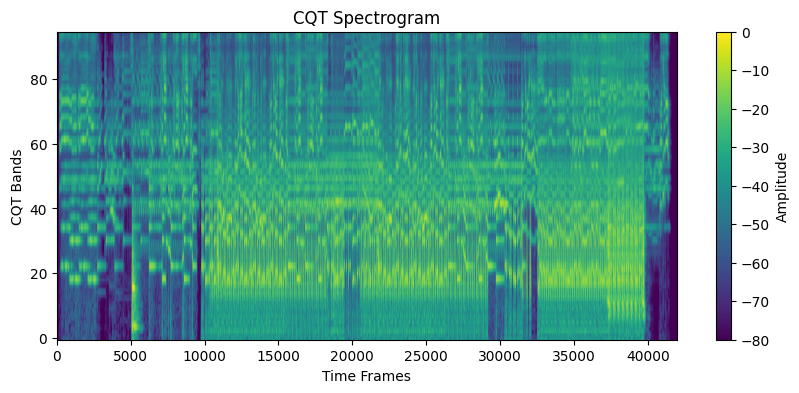

In [21]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 4))
plt.imshow(cqt_feture, aspect='auto', origin='lower', cmap='viridis')
plt.colorbar(label='Amplitude')
plt.title('CQT Spectrogram')
plt.xlabel('Time Frames')
plt.ylabel('CQT Bands')
plt.show()

In [ ]:
INPUT_FOLDER = "D:\\Underwater_Data\\Inc_4000_Exc_6000"  # Replace with your folder path
OUTPUT_FOLDER = "D:\\Underwater_Data\\CQT_46"  # Where features will be saved
os.makedirs(OUTPUT_FOLDER, exist_ok=True)
def process_dataset_cqt(input_folder, output_folder):
    for split in ['test', 'train','validation']:  # Process each split
        split_path = os.path.join(input_folder, split)
        output_split_folder = os.path.join(output_folder, split)
        os.makedirs(output_split_folder, exist_ok=True)

        for class_name in os.listdir(split_path):  # Iterate over class folders
            class_path = os.path.join(split_path, class_name)

            if os.path.isdir(class_path):  # Ensure it's a directory
                print(f"Processing {split}/{class_name}")
                output_class_folder = os.path.join(output_split_folder, class_name)
                os.makedirs(output_class_folder, exist_ok=True)

                for file_name in os.listdir(class_path):
                    if file_name.endswith('.wav'):
                        file_path = os.path.join(class_path, file_name)
                        cqt_spec =cqt_features(file_path)

                        if cqt_spec is not None:
                            # Save the Mel spectrogram as a .npy file
                            output_file_path = os.path.join(output_class_folder, file_name.replace('.wav', '.npy'))
                            np.save(output_file_path, cqt_spec)
                            print(f"Saved Mel spectrogram: {output_file_path}")

In [ ]:
process_dataset_cqt(INPUT_FOLDER, OUTPUT_FOLDER)

Processing test/background
Saved Mel spectrogram: D:\Underwater_Data\CQT_46\test\background\100.npy
Saved Mel spectrogram: D:\Underwater_Data\CQT_46\test\background\1004.npy
Saved Mel spectrogram: D:\Underwater_Data\CQT_46\test\background\1005.npy
Saved Mel spectrogram: D:\Underwater_Data\CQT_46\test\background\1007.npy
Saved Mel spectrogram: D:\Underwater_Data\CQT_46\test\background\101.npy
Saved Mel spectrogram: D:\Underwater_Data\CQT_46\test\background\1011.npy
Saved Mel spectrogram: D:\Underwater_Data\CQT_46\test\background\1012.npy
Saved Mel spectrogram: D:\Underwater_Data\CQT_46\test\background\1013.npy
Saved Mel spectrogram: D:\Underwater_Data\CQT_46\test\background\1016.npy
Saved Mel spectrogram: D:\Underwater_Data\CQT_46\test\background\1018.npy
Saved Mel spectrogram: D:\Underwater_Data\CQT_46\test\background\1020.npy
Saved Mel spectrogram: D:\Underwater_Data\CQT_46\test\background\1022.npy
Saved Mel spectrogram: D:\Underwater_Data\CQT_46\test\background\1023.npy
Saved Mel spe

**4. MFCC feature extraction**

In [ ]:
def extract_mfcc_1d(file_path, n_mfcc=45):
    audio, sr = librosa.load(file_path, sr=22050)
    mfcc = librosa.feature.mfcc(
        y=audio,
        sr=sr,
        n_fft=2048,
        hop_length=512,
        n_mels=50,
        n_mfcc=n_mfcc
    )
    mfcc_1d = mfcc.flatten()
    return mfcc_1d

In [ ]:
INPUT_FOLDER = 'D:\\Underwater_Data\\Inc_2000_Exc_4000'  # Replace with your folder path
OUTPUT_FOLDER = 'D:\\Underwater_Data\\MFCC'  # Where features will be saved
os.makedirs(OUTPUT_FOLDER, exist_ok=True)
def process_dataset_mfcc(input_folder, output_folder):
    for split in ['test', 'train','validation']:  # Process each split
        split_path = os.path.join(input_folder, split)
        output_split_folder = os.path.join(output_folder, split)
        os.makedirs(output_split_folder, exist_ok=True)
        for class_name in os.listdir(split_path):  # Iterate over class folders
            class_path = os.path.join(split_path, class_name)
            if os.path.isdir(class_path):  # Ensure it's a directory
                print(f"Processing {split}/{class_name}")
                output_class_folder = os.path.join(output_split_folder, class_name)
                os.makedirs(output_class_folder, exist_ok=True)
                for file_name in os.listdir(class_path):
                    if file_name.endswith('.wav'):
                        file_path = os.path.join(class_path, file_name)
                        mfcc =extract_mfcc_1d(file_path)
                        if mel_spec is not None:
                            output_file_path = os.path.join(output_class_folder, file_name.replace('.wav', '.npy'))
                            np.save(output_file_path, mfcc)
                            print(f"Saved Mel spectrogram: {output_file_path}")

In [ ]:
process_dataset_mfcc(INPUT_FOLDER, OUTPUT_FOLDER)

**6. STFT feature extraction technique**

In [ ]:
def extract_stft_features(audio_path,sr=22050,n_fft=2024,hop_length=512):
    y, sr = librosa.load(audio_path, sr=sr)
    stft_matrix = librosa.stft(y, n_fft=n_fft, hop_length=hop_length)
    stft_magnitude = np.abs(stft_matrix)
    stft_db = librosa.amplitude_to_db(stft_magnitude, ref=np.max)
    return stft_db

In [ ]:
INPUT_FOLDER = 'D:\\Underwater_Data\\Inc_2000_Exc_4000'
OUTPUT_FOLDER = 'D:\\Underwater_Data\\STFT'
os.makedirs(OUTPUT_FOLDER, exist_ok=True)
def process_dataset_stft(input_folder, output_folder):
    for split in ['test', 'train','validation']:
        split_path = os.path.join(input_folder, split)
        output_split_folder = os.path.join(output_folder, split)
        os.makedirs(output_split_folder, exist_ok=True)
        for class_name in os.listdir(split_path):
            class_path = os.path.join(split_path, class_name)
            if os.path.isdir(class_path):
                print(f"Processing {split}/{class_name}")
                output_class_folder = os.path.join(output_split_folder, class_name)
                os.makedirs(output_class_folder, exist_ok=True)
                for file_name in os.listdir(class_path):
                    if file_name.endswith('.wav'):
                        file_path = os.path.join(class_path, file_name)
                        mfcc =extract_stft_features(file_path)
                        if mfcc is not None:
                            output_file_path = os.path.join(output_class_folder, file_name.replace('.wav', '.npy'))
                            np.save(output_file_path, mfcc)
                            print(f"Saved Mel spectrogram: {output_file_path}")

In [ ]:
process_dataset_stft(INPUT_FOLDER, OUTPUT_FOLDER)

In [ ]:
!pip install kymatio librosa numpy matplotlib

Note: you may need to restart the kernel to use updated packages.


**7. WST feature extraction**

In [15]:
from kymatio.numpy import Scattering1D

In [97]:
def extract_wst_features(audio_path, sr=22050, J=4, Q=6,T=32768):
    y, sr = librosa.load(audio_path, sr=sr)
    y = np.pad(y, (0, T - len(y)), mode='constant')
    scattering = Scattering1D(J=J, shape=(T,), Q=Q)
    S = scattering(y)
    return S

In [92]:
S = extract_wst_features("D:\\Underwater_Data\\Inc_2000_Exc_4000\\test\\tanker\\2.wav")
S.shape

(40, 2048)

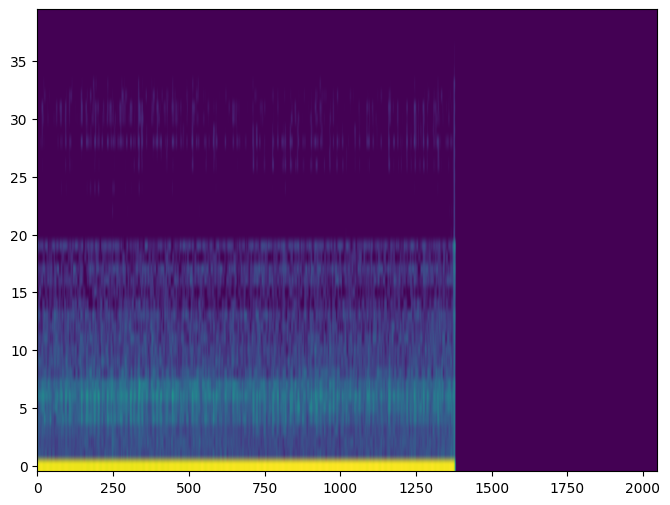

In [93]:
stft_db = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize=(8, 6))  # 4x4 inches * 56 DPI = 224x224
plt.imshow(stft_db, aspect="auto",origin="lower", cmap="viridis")
plt.show()

In [98]:
import os

In [99]:
INPUT_FOLDER = 'D:\\Underwater_Data\\Inc_2000_Exc_4000'  # Replace with your folder path
OUTPUT_FOLDER = 'D:\\Underwater_Data\\WST'  # Where features will be saved
os.makedirs(OUTPUT_FOLDER, exist_ok=True)
def process_dataset_wst(input_folder, output_folder):
    for split in ['test', 'train','validation']:  # Process each split
        split_path = os.path.join(input_folder, split)
        output_split_folder = os.path.join(output_folder, split)
        os.makedirs(output_split_folder, exist_ok=True)
        for class_name in os.listdir(split_path):  # Iterate over class folders
            class_path = os.path.join(split_path, class_name)
            if os.path.isdir(class_path):  # Ensure it's a directory
                print(f"Processing {split}/{class_name}")
                output_class_folder = os.path.join(output_split_folder, class_name)
                os.makedirs(output_class_folder, exist_ok=True)
                for file_name in os.listdir(class_path):
                    if file_name.endswith('.wav'):
                        file_path = os.path.join(class_path, file_name)
                        wst =extract_wst_features(file_path)
                        if wst is not None:
                            output_file_path = os.path.join(output_class_folder, file_name.replace('.wav', '.npy'))
                            np.save(output_file_path, wst)
                            print(f"Saved Mel spectrogram: {output_file_path}")

In [ ]:
process_dataset_wst(INPUT_FOLDER, OUTPUT_FOLDER)

Processing test/background
Saved Mel spectrogram: D:\Underwater_Data\WST\test\background\0.npy
Saved Mel spectrogram: D:\Underwater_Data\WST\test\background\1.npy
Saved Mel spectrogram: D:\Underwater_Data\WST\test\background\10.npy
Saved Mel spectrogram: D:\Underwater_Data\WST\test\background\1005.npy
Saved Mel spectrogram: D:\Underwater_Data\WST\test\background\1008.npy
Saved Mel spectrogram: D:\Underwater_Data\WST\test\background\1012.npy
Saved Mel spectrogram: D:\Underwater_Data\WST\test\background\1017.npy
Saved Mel spectrogram: D:\Underwater_Data\WST\test\background\102.npy
Saved Mel spectrogram: D:\Underwater_Data\WST\test\background\1022.npy
Saved Mel spectrogram: D:\Underwater_Data\WST\test\background\1025.npy
Saved Mel spectrogram: D:\Underwater_Data\WST\test\background\1031.npy
Saved Mel spectrogram: D:\Underwater_Data\WST\test\background\1036.npy
Saved Mel spectrogram: D:\Underwater_Data\WST\test\background\1038.npy
Saved Mel spectrogram: D:\Underwater_Data\WST\test\backgrou

**Concatenation of Mel spectrogram CQT and Gammatone**

In [3]:
import os
import numpy as np
input_folders = ["D:\\Underwater_Data\\CQT_46", "D:\\Underwater_Data\\GAMM_46","D:\\Underwater_Data\\MELSPECTROGRAM_46"]  # These contain test, train, validation
output_folder = "D:\\Underwater_Data\\COMBINED_THREE_46"  # New merged folder
os.makedirs(output_folder, exist_ok=True)
dataset_types = ["test", "train", "validation"]  # Subdirectories in each folder
classes = ["background", "cargo", "passengership", "tanker", "tug"]  # Class names
for dataset_type in dataset_types:
    dataset_path = os.path.join(output_folder, dataset_type)
    os.makedirs(dataset_path, exist_ok=True)  # Create test/train/validation in output folder
    for class_name in classes:
        class_path = os.path.join(dataset_path, class_name)
        os.makedirs(class_path, exist_ok=True)  # Create class folder
        reference_folder = os.path.join(input_folders[0], dataset_type, class_name)
        feature_files = sorted(os.listdir(reference_folder))  # Sorted file list
        for feature_file in feature_files:
            features_list = [
                np.load(os.path.join(folder, dataset_type, class_name, feature_file))
                for folder in input_folders
            ]
            combined_features = np.stack(features_list, axis=0)
            save_path = os.path.join(class_path, feature_file)
            np.save(save_path, combined_features)
print("Feature files successfully combined and saved in 'Combined_three_features' folder!")

Feature files successfully combined and saved in 'Combined_three_features' folder!


**Deep learning model design**

In [155]:
pip install torch torchvision numpy

Note: you may need to restart the kernel to use updated packages.


In [156]:
pip install livelossplot

Note: you may need to restart the kernel to use updated packages.


In [157]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torchvision.models import resnet18
from torch.utils.data import Dataset, DataLoader
import numpy as np
import os
from torchsummary import summary
import copy
from torch.optim import lr_scheduler
from livelossplot import PlotLosses
import json
import time

In [158]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [333]:
WEIGHTS_DIR ='Resnet'
#[MODEL]
MODEL_NAME = 'Combined'
#N_RESBLOCKS = 4

SEED = 11
LR = 0.001
BS = 8
EPOCHS =40
MOMENTUM = 0.8
LR_DECAY = 0.1
LR_PATIENCE =3

In [ ]:
class MelSpectrogramDataset(Dataset):
    def __init__(self, data_dir):
        self.data_dir = data_dir
        self.classes = sorted(os.listdir(data_dir))  # Get class names
        self.file_paths = []
        self.labels = []

        for class_idx, class_name in enumerate(self.classes):
            class_path = os.path.join(data_dir, class_name)

            # Skip system folders like `.ipynb_checkpoints`
            if class_name == ".ipynb_checkpoints":
                continue

            for file in os.listdir(class_path):
                file_path = os.path.join(class_path, file)

                # Check if it's a valid `.npy` file
                if file.endswith(".npy"):
                    self.file_paths.append(file_path)
                    self.labels.append(class_idx)

    def __len__(self):
        return len(self.file_paths)

    def __getitem__(self, idx):
        file_path = self.file_paths[idx]
        mel_spec = np.load(file_path)

        mel_spec = torch.tensor(mel_spec, dtype=torch.float32)
        mel_spec = mel_spec.unsqueeze(0)  # Shape: (1, 193)# Convert to Tensor
        label = torch.tensor(self.labels[idx], dtype=torch.long)

        return mel_spec, label

NameError: name 'Dataset' is not defined

In [335]:
train_dataset = MelSpectrogramDataset("D:\\Underwater_Data\\Combined_three_features_Ver2_3500\\train")
val_dataset = MelSpectrogramDataset("Combined_three_features/validation")
test_dataset=MelSpectrogramDataset("Combined_three_features/test")
train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)
dataloaders = {'train': train_loader, 'validation': val_loader}
dataset_sizes = {'train': len(train_dataset), 'validation': len(val_dataset)}

In [336]:
backbone=resnet18(pretrained=True)

In [337]:
PRETRAINED = True
FINETUNE = False
if PRETRAINED and not FINETUNE:
    for param in backbone.parameters():
        param.requires_grad = False

In [338]:
class ResNetAudio(nn.Module):
    def __init__(self, backbone,num_classes):
        super(ResNetAudio, self).__init__()
        self.resnet = backbone  # Load ResNet18
        num_features = self.resnet.fc.in_features
        self.resnet.conv1 = nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1, bias=False)
        self.resnet.fc = nn.Sequential(
                nn.Linear(num_features, 256),  # 512 → 256
                nn.ReLU(),
                nn.Dropout(0.5),  # Dropout to prevent overfitting
                nn.Linear(256, 128),  # 256 → 128
                nn.ReLU(),
                nn.Dropout(0.5),
                nn.Linear(128, num_classes)  # 128 → Output classes
            )
    def forward(self, x):
        return self.resnet(x)

In [174]:
model=ResNetAudio(backbone,num_classes=5).to(device)  # 5 classes

In [175]:
summary(model,(3,224,224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           1,728
       BatchNorm2d-2         [-1, 64, 224, 224]             128
              ReLU-3         [-1, 64, 224, 224]               0
         MaxPool2d-4         [-1, 64, 112, 112]               0
            Conv2d-5         [-1, 64, 112, 112]          36,864
       BatchNorm2d-6         [-1, 64, 112, 112]             128
              ReLU-7         [-1, 64, 112, 112]               0
            Conv2d-8         [-1, 64, 112, 112]          36,864
       BatchNorm2d-9         [-1, 64, 112, 112]             128
             ReLU-10         [-1, 64, 112, 112]               0
       BasicBlock-11         [-1, 64, 112, 112]               0
           Conv2d-12         [-1, 64, 112, 112]          36,864
      BatchNorm2d-13         [-1, 64, 112, 112]             128
             ReLU-14         [-1, 64, 1

In [176]:
import torch.optim as optim
from torch.optim.lr_scheduler import ExponentialLR
from torchvision import models

In [ ]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)
scheduler = ExponentialLR(optimizer, gamma=0.95)

# Training function
def train_model(model, criterion, optimizer, scheduler, dataloaders, dataset_sizes,batch_size,num_epochs=40):
    since = time.time()
    best_model_wts = model.state_dict()
    best_acc = 0.0
    train_losses, val_losses = [], []
    train_accuracies, val_accuracies = [], []

    for epoch in range(num_epochs):
        for phase in ['train', 'validation']:
            if phase == 'train':
                model.train()
            else:
                model.eval()
            running_loss = 0.0
            running_corrects = 0
            n_batches = dataset_sizes[phase] // batch_size
            for it, (inputs, labels) in enumerate(dataloaders[phase]):
                inputs, labels = inputs.to(device), labels.to(device)
                optimizer.zero_grad()
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
                print(
                    f"Epoch: {epoch+1}/{num_epochs} Iter: {it+1}/{n_batches}",
                    end="\r",
                    flush=True,
                )
            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]
            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')
            if phase == 'train':
                train_losses.append(epoch_loss)
                train_accuracies.append(epoch_acc.item())
            if phase == 'validation':
                val_losses.append(epoch_loss)
                val_accuracies.append(epoch_acc.item())
                scheduler.step(epoch_loss)  # Reduce LR if val_loss does not improve
                last_lr = scheduler.get_last_lr()
                print(f"Epoch {epoch+1}, Learning Rate: {last_lr}")
            if phase == 'validation' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = model.state_dict()
    history = {
        "train_loss": train_losses,
        "val_loss": val_losses,
        "train_acc": train_accuracies,
        "val_acc": val_accuracies
    }
    with open("Resnet/SGD_training_history.json", "w") as f:
        json.dump(history, f)
    torch.save(best_model_wts, "Resnet/SGD_best_model.pth")
    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best validation accuracy: {best_acc:.4f}')
    model.load_state_dict(best_model_wts)
    return model

In [178]:
trained_model = train_model(model, criterion, optimizer,scheduler,dataloaders,dataset_sizes,batch_size=8,num_epochs=100)

train Loss: 1.0782 Acc: 0.5482
Updated Learning Rate: 0.000950
validation Loss: 0.7617 Acc: 0.6290
train Loss: 0.8874 Acc: 0.6440
Updated Learning Rate: 0.000902
validation Loss: 0.7090 Acc: 0.6872
train Loss: 0.8117 Acc: 0.6780
Updated Learning Rate: 0.000857
validation Loss: 0.6325 Acc: 0.7314
train Loss: 0.7654 Acc: 0.6986
Updated Learning Rate: 0.000815
validation Loss: 0.6301 Acc: 0.7306
train Loss: 0.7269 Acc: 0.7133
Updated Learning Rate: 0.000774
validation Loss: 0.5527 Acc: 0.7646
train Loss: 0.6947 Acc: 0.7240
Updated Learning Rate: 0.000735
validation Loss: 0.6003 Acc: 0.7186
train Loss: 0.6770 Acc: 0.7365
Updated Learning Rate: 0.000698
validation Loss: 0.5690 Acc: 0.7489
train Loss: 0.6586 Acc: 0.7427
Updated Learning Rate: 0.000663
validation Loss: 0.5540 Acc: 0.7617
train Loss: 0.6445 Acc: 0.7471
Updated Learning Rate: 0.000630
validation Loss: 0.5466 Acc: 0.7569
train Loss: 0.6282 Acc: 0.7524
Updated Learning Rate: 0.000599
validation Loss: 0.5157 Acc: 0.7827
train Loss

In [179]:
with open("Resnet/SGD_training_history.json", "r") as f:
    history = json.load(f)

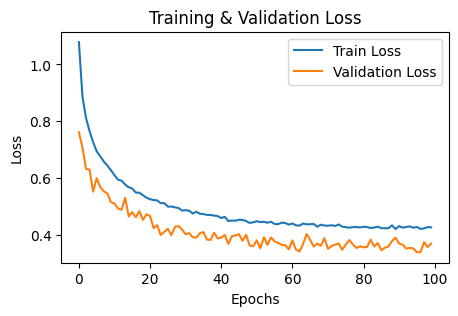

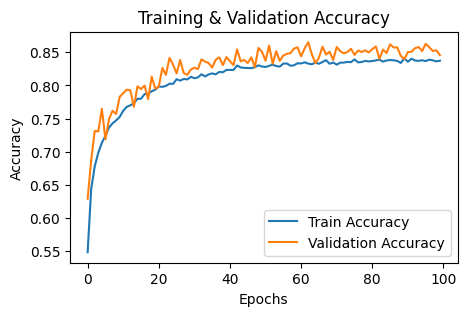

In [180]:
plt.figure(figsize=(5, 3))
plt.plot(history["train_loss"], label="Train Loss")
plt.plot(history["val_loss"], label="Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Training & Validation Loss")
plt.legend()
plt.show()

# Plot training and validation accuracy
plt.figure(figsize=(5, 3))
plt.plot(history["train_acc"], label="Train Accuracy")
plt.plot(history["val_acc"], label="Validation Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title("Training & Validation Accuracy")
plt.legend()
plt.show()

In [181]:
backbone=resnet18(pretrained=True)

In [182]:
model=ResNetAudio(backbone,num_classes=5).to(device)  # 5 classes

In [183]:
model_weights ='Resnet/SGD_best_model.pth'
model.load_state_dict(torch.load(model_weights, map_location=device))
model.eval()

C:\Users\IIT\AppData\Local\Temp\ipykernel_31832\810163108.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_weights, map_location=de

ResNetAudio(
  (resnet): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_

In [184]:
def test_model(device, model, test_loader, idx2class=None):
    y_pred_list = []
    y_true_list = []
    y_pred_prob=[]
    with torch.no_grad():
        for x_batch, y_batch in test_loader:
            x_batch, y_batch = x_batch.to(device), y_batch.to(device)
            y_test_pred = model(x_batch)
            _, y_pred_tag = torch.max(y_test_pred, dim = 1)
            y_pred_list.append(y_pred_tag.cpu().numpy())
            y_true_list.append(y_batch.cpu().numpy())
            y_pred_prob.append(y_test_pred.cpu().numpy())
    y_pred_list = [i[0] for i in y_pred_list]
    y_true_list = [i[0] for i in y_true_list]

    return y_true_list, y_pred_list,y_pred_prob

In [185]:
print('*' * 50)
print('Testing started:')
y_true, y_pred,y_pred_prob = test_model(device=device, model=model, test_loader=test_loader)
resulting_array = np.vstack(y_pred_prob)

**************************************************
Testing started:


In [186]:
class_labels=['Background', 'Cargo', 'Passengership', 'Tanker', 'Tug']

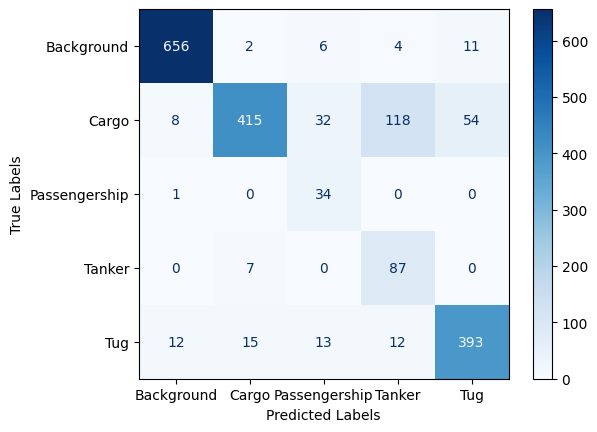

In [187]:
cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [190]:
print(classification_report(y_true, y_pred))

              precision    recall  f1-score   support

           0       0.97      0.97      0.97       679
           1       0.95      0.66      0.78       627
           2       0.40      0.97      0.57        35
           3       0.39      0.93      0.55        94
           4       0.86      0.88      0.87       445

    accuracy                           0.84      1880
   macro avg       0.71      0.88      0.75      1880
weighted avg       0.90      0.84      0.85      1880



In [191]:
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import roc_auc_score

In [192]:
y_true_bin = label_binarize(y_true, classes=np.unique(y_true))
y_true_bin = label_binarize(y_true, classes=np.unique(y_true))
# Calculate micro-average ROC AUC
roc_auc = roc_auc_score(y_true_bin, resulting_array, multi_class='ovr')
print("ROC AUC:", roc_auc)

ROC AUC: 0.96325593411967


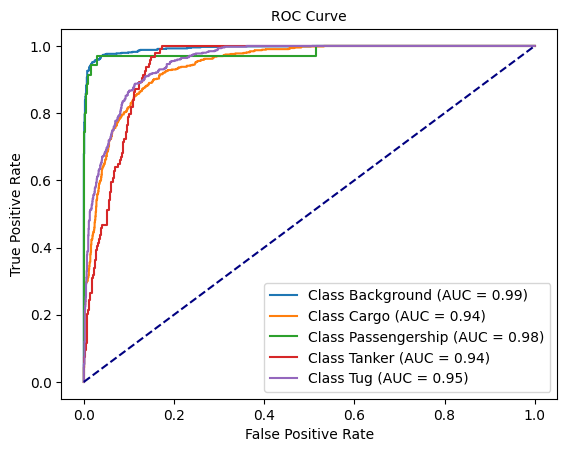

In [193]:
for i in range(resulting_array.shape[1]):
    fpr, tpr, _ = roc_curve(y_true_bin[:, i], resulting_array[:, i])
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f"Class {class_labels[i]} (AUC = {roc_auc:.2f})")

plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlabel('False Positive Rate',fontsize=10)
plt.ylabel('True Positive Rate',fontsize=10)
plt.title('ROC Curve',fontsize=10)
plt.legend(loc="lower right",fontsize=10)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
#plt.savefig('/content/drive/MyDrive/font_images/nalvgg_100_ROC_AUC.png',dpi=600)

plt.show()

**Quantum Models**

In [194]:
!pip install pennylane

In [200]:
pip install pennylane pennylane-lightning pennylane-lightning-gpu --upgrad

Note: you may need to restart the kernel to use updated packages.



Usage:   
  C:\Users\IIT\anaconda3\envs\pytorch_env\python.exe -m pip install [options] <requirement specifier> [package-index-options] ...
  C:\Users\IIT\anaconda3\envs\pytorch_env\python.exe -m pip install [options] -r <requirements file> [package-index-options] ...
  C:\Users\IIT\anaconda3\envs\pytorch_env\python.exe -m pip install [options] [-e] <vcs project url> ...
  C:\Users\IIT\anaconda3\envs\pytorch_env\python.exe -m pip install [options] [-e] <local project path> ...
  C:\Users\IIT\anaconda3\envs\pytorch_env\python.exe -m pip install [options] <archive url/path> ...

ambiguous option: --upgrad (--upgrade, --upgrade-strategy?)


In [383]:
#[QUANTUM]
QUANTUM = True
L2_NORM =True
N_QBITS = 5
N_VQC = 1
Q_DEPTH =1

In [384]:
import pennylane as qml
from pennylane import numpy as np

In [385]:
wires = 5
dev = qml.device("lightning.qubit", wires=wires)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [386]:
def H_layer(nqubits):
    for idx in range(nqubits):
        qml.Hadamard(wires=idx)
def RY_layer(w):
    for idx, element in enumerate(w):
        qml.RY(element, wires=idx)
def RX_layer(w):
    for idx, element in enumerate(w):
        qml.RX(element, wires=idx)
def RZ_layer(w):
    for idx, element in enumerate(w):
        qml.RZ(element, wires=idx)
def entangling_layer(nqubits):
    for i in range(0, nqubits - 1, 2):  # Loop over even indices: i=0,2,...N-2
        qml.CNOT(wires=[i, i + 1])
    for i in range(1, nqubits - 1, 2):  # Loop over odd indices:  i=1,3,...N-3
        qml.CNOT(wires=[i, i + 1])

In [387]:
@qml.qnode(dev, interface="torch")
def quantum_net(q_input_features, q_weights_flat, q_depth=4, n_qubits=4):
    q_weights = q_weights_flat.reshape(q_depth,2,n_qubits)
    H_layer(n_qubits)
    RY_layer(q_input_features)
    for k in range(q_depth):
        #RZ_layer(q_weights[k][0])
        RY_layer(q_weights[k][0])
        #RZ_layer(q_weights[k][1])
        entangling_layer(n_qubits)
    exp_vals = [qml.expval(qml.PauliZ(position)) for position in range(n_qubits)]
    return tuple(exp_vals)

In [388]:
class QuantumLayer(nn.Module):
    """ Quantum mapping layer """
    def __init__(self,q_depth=4, n_qubits=5, q_delta=0.01):
        super().__init__()
        self.q_depth = q_depth
        self.n_qubits = n_qubits
        self.q_params = nn.Parameter(q_delta * torch.randn(q_depth *2*n_qubits))
    def forward(self, x):
        q_in = torch.tanh(x) * np.pi / 2.0
        q_out = torch.Tensor(0, self.n_qubits)
        q_out = q_out.to(device)
        for elem in q_in:
            q_out_elem = torch.hstack(quantum_net(elem, self.q_params, self.q_depth, self.n_qubits)).float().unsqueeze(0)
            q_out = torch.cat((q_out, q_out_elem))
        return q_out

In [389]:
class QuantumImagenetTransferLearning(nn.Module):
    def __init__(self, num_target_classes, backbone,q_depth=3, n_qubits=4,n_qlayers = 4):
        super().__init__()
        if n_qubits != wires:
            print('[WARNING]: Number of qubits: {} must be the same number of wires: {}'.format(n_qubits, wires))
            raise Exception("Please set a corret number of wires in .py file or change the number of qubits")
        self.last_layer=n_qubits*n_qlayers
        self.num_target_classes = num_target_classes
        self.n_qlayers = n_qlayers
        self.resnet = nn.Sequential(*list(backbone.children())[:-1])
        self.final_reduction=nn.Linear(512,self.last_layer)
        q_layers_list = [QuantumLayer(q_depth=q_depth, n_qubits=n_qubits)for _ in range(n_qlayers)]
        self.q_layers = torch.nn.Sequential(*q_layers_list)
        self.q_classifier = nn.Linear(self.last_layer, self.num_target_classes)
    def forward(self, x):
        x = self.resnet(x)
        x = torch.flatten(x, 1)
        x=self.final_reduction(x)
        features_split = torch.split(x, self.last_layer // self.n_qlayers, dim=1)
        q_features = [q_layer(feature) for q_layer, feature in zip(self.q_layers, features_split)]
        q_features = torch.cat(q_features, axis=1)
        y =  self.q_classifier(q_features)
        return y

In [390]:
backbone=resnet18(pretrained=True)

In [391]:
PRETRAINED = True
FINETUNE = False
if PRETRAINED and not FINETUNE:
    for param in backbone.parameters():
        param.requires_grad = False

In [392]:
model = QuantumImagenetTransferLearning(num_target_classes=5, backbone=backbone,q_depth=Q_DEPTH,
            n_qubits=N_QBITS,n_qlayers=N_VQC)
model = model.to(device)

In [393]:
summary(model,(3,224,224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]          36,864
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
       BasicBlock-11           [-1, 64, 56, 56]               0
           Conv2d-12           [-1, 64, 56, 56]          36,864
      BatchNorm2d-13           [-1, 64, 56, 56]             128
             ReLU-14           [-1, 64,

In [394]:
dataloaders = {'train': train_loader, 'validation': val_loader}
dataset_sizes = {'train': len(train_dataset), 'validation': len(val_dataset)}

In [395]:
device

device(type='cuda', index=0)

In [396]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', patience=3, factor=0.5, verbose=True)
trained_model = train_model(model, criterion, optimizer,scheduler,dataloaders,dataset_sizes,batch_size=8,num_epochs=50)

train Loss: 1.2737 Acc: 0.4493
validation Loss: 1.2707 Acc: 0.4843
Epoch 1, Learning Rate: [0.001]
train Loss: 1.2121 Acc: 0.4714
validation Loss: 1.2243 Acc: 0.5053
Epoch 2, Learning Rate: [0.001]
train Loss: 1.1966 Acc: 0.4755
validation Loss: 1.2359 Acc: 0.4960
Epoch 3, Learning Rate: [0.001]
train Loss: 1.1875 Acc: 0.4794
validation Loss: 1.1510 Acc: 0.3936
Epoch 4, Learning Rate: [0.001]
train Loss: 1.1973 Acc: 0.4727
validation Loss: 1.2087 Acc: 0.4981
Epoch 5, Learning Rate: [0.001]
train Loss: 1.1817 Acc: 0.4787
validation Loss: 1.3650 Acc: 0.5032
Epoch 6, Learning Rate: [0.001]
train Loss: 1.1831 Acc: 0.4775
validation Loss: 1.2094 Acc: 0.4976
Epoch 7, Learning Rate: [0.001]
train Loss: 1.1749 Acc: 0.4797
validation Loss: 1.2421 Acc: 0.3128
Epoch 8, Learning Rate: [0.0005]
train Loss: 1.1661 Acc: 0.4841
validation Loss: 1.1714 Acc: 0.3856
Epoch 9, Learning Rate: [0.0005]
train Loss: 1.1669 Acc: 0.4835
validation Loss: 1.1512 Acc: 0.5133
Epoch 10, Learning Rate: [0.0005]
train 

KeyboardInterrupt: 

In [332]:
import os
import shutil
import random
source_dir = "D:\\Underwater_Data\\Combined_three_features_Ver2\\train"
destination_dir = "D:\\Underwater_Data\\Combined_three_features_Ver2_3500\\train"
os.makedirs(destination_dir, exist_ok=True)
for class_name in os.listdir(source_dir):
    class_path = os.path.join(source_dir, class_name)
    new_class_path = os.path.join(destination_dir, class_name)
    if os.path.isdir(class_path):
        os.makedirs(new_class_path, exist_ok=True)
        npy_files = [f for f in os.listdir(class_path) if f.endswith('.npy')]
        selected_files = random.sample(npy_files, 3500)
        for file in selected_files:
            shutil.copy(os.path.join(class_path, file), os.path.join(new_class_path, file))

In [4]:
import librosa
import numpy as np
import matplotlib.pyplot as plt
import pywt
import cv2

In [5]:
def extract_cwt_features(audio_path, sr=, scales=np.arange(1, 129), wavelet='cmor'):
    y, sr = librosa.load(audio_path, sr=sr)
    coefficients, frequencies = pywt.cwt(y, scales, wavelet, sampling_period=1/sr)
    return coefficients

In [7]:
cwt=extract_cwt_features("D:\\Underwater_Data\\Inc_2000_Exc_4000\\test\\tanker\\2.wav")

In [8]:
cwt.shape

(128, 22050)

In [29]:
import os

In [32]:
INPUT_FOLDER = 'D:\\Underwater_Data\\Inc_2000_Exc_4000'  # Replace with your folder path
OUTPUT_FOLDER = 'D:\\Underwater_Data\\STFT'  # Where features will be saved
os.makedirs(OUTPUT_FOLDER, exist_ok=True)
def process_dataset_stft(input_folder, output_folder):
    for split in ['test', 'train','validation']:  # Process each split
        split_path = os.path.join(input_folder, split)
        output_split_folder = os.path.join(output_folder, split)
        os.makedirs(output_split_folder, exist_ok=True)
        for class_name in os.listdir(split_path):  # Iterate over class folders
            class_path = os.path.join(split_path, class_name)
            if os.path.isdir(class_path):  # Ensure it's a directory
                print(f"Processing {split}/{class_name}")
                output_class_folder = os.path.join(output_split_folder, class_name)
                os.makedirs(output_class_folder, exist_ok=True)
                for file_name in os.listdir(class_path):
                    if file_name.endswith('.wav'):
                        file_path = os.path.join(class_path, file_name)
                        mfcc =extract_stft_features(file_path)
                        if mfcc is not None:
                            output_file_path = os.path.join(output_class_folder, file_name.replace('.wav', '.npy'))
                            np.save(output_file_path, mfcc)
                            print(f"Saved Mel spectrogram: {output_file_path}")

In [ ]:
process_dataset_stft(INPUT_FOLDER, OUTPUT_FOLDER)

Processing test/background
Saved Mel spectrogram: D:\Underwater_Data\STFT\test\background\0.npy
Saved Mel spectrogram: D:\Underwater_Data\STFT\test\background\1.npy
Saved Mel spectrogram: D:\Underwater_Data\STFT\test\background\10.npy
Saved Mel spectrogram: D:\Underwater_Data\STFT\test\background\1005.npy
Saved Mel spectrogram: D:\Underwater_Data\STFT\test\background\1008.npy
Saved Mel spectrogram: D:\Underwater_Data\STFT\test\background\1012.npy
Saved Mel spectrogram: D:\Underwater_Data\STFT\test\background\1017.npy
Saved Mel spectrogram: D:\Underwater_Data\STFT\test\background\102.npy
Saved Mel spectrogram: D:\Underwater_Data\STFT\test\background\1022.npy
Saved Mel spectrogram: D:\Underwater_Data\STFT\test\background\1025.npy
Saved Mel spectrogram: D:\Underwater_Data\STFT\test\background\1031.npy
Saved Mel spectrogram: D:\Underwater_Data\STFT\test\background\1036.npy
Saved Mel spectrogram: D:\Underwater_Data\STFT\test\background\1038.npy
Saved Mel spectrogram: D:\Underwater_Data\STFT